In [2]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from lifelines import KaplanMeierFitter

np.random.seed(42)
df = pd.DataFrame({
    "time": np.random.exponential(10, 100),
    "event": np.random.randint(0, 2, 100),
    "group": np.random.choice(["A", "B", "C"], 100)
})

In [17]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sksurv.nonparametric import kaplan_meier_estimator  # Kaplan-Meier estimation
from lifelines.statistics import logrank_test  # Log-rank test from lifelines

# Sample Data
np.random.seed(42)
df = pd.DataFrame({
    "time": np.random.exponential(10, 100),
    "event": np.random.randint(0, 2, 100),  # 0 or 1 (needs conversion)
    "group": np.random.choice(["A", "B", "C"], 100)
})

# Convert event column to boolean (Required for sksurv)
df["event"] = df["event"].astype(bool)  # ✅ Fix: Convert 0/1 to False/True

# Initialize Plotly figure
fig = go.Figure()

# Kaplan-Meier estimation for each group
for group in df["group"].unique():
    mask = df["group"] == group

    # Get time and event data for the group
    time_points, survival_probs = kaplan_meier_estimator(df["event"][mask], df["time"][mask])

    fig.add_trace(go.Scatter(
        x=time_points,
        y=survival_probs,
        mode="lines",
        name=f"Group {group}"
    ))

# Compute Log-Rank Test for two groups (e.g., A vs. B)
group_A = df[df["group"] == "A"]
group_B = df[df["group"] == "B"]

logrank_result = logrank_test(
    group_A["time"], group_B["time"], event_observed_A=group_A["event"], event_observed_B=group_B["event"]
)

p_value = logrank_result.p_value  # Extract p-value

# Add p-value to the plot title
fig.update_layout(
    title=f"Kaplan-Meier Survival Curves (Log-Rank p={p_value:.4f})",
    xaxis_title="Time",
    yaxis_title="Survival Probability",
    template="plotly_white"
)

fig.show()

print(f"Log-Rank Test p-value: {p_value:.4f}")


Log-Rank Test p-value: 0.1017


In [14]:
import sksurv
print(sksurv.__version__)

0.24.1


# SVC Probability and kernel studies

## Kernel studies

In [1]:
import numpy as np
from scipy.spatial.distance import euclidean

X = np.array([1000, 1005, 4000, 5000])


def rbf(gamma, a, b):
    return np.exp(-gamma * euclidean(a, b))



gamma = 0.001
a = [X[0]]
b = [X[1]]
print(rbf(gamma, a, b))
a = [X[0]]
b = [X[2]]
print(rbf(gamma, a, b))
a = [X[0]]
b = [X[3]]
print(rbf(gamma, a, b))

0.9950124791926823
0.049787068367863944
0.01831563888873418


## Conditional probabilities

### Plot Data

Text(0.5, 1.0, 'Created Data')

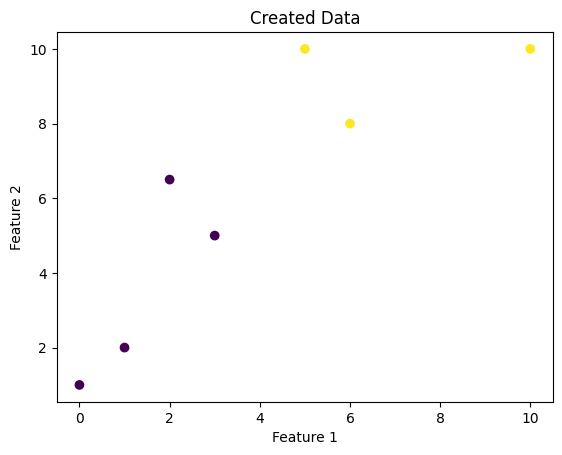

In [2]:
import matplotlib.pyplot as plt
import numpy as np

X = np.array([[0,1], [1, 2], [2, 6.5], [3, 5], [5, 10], [6,8], [10, 10]])
y = np.array([0, 0, 0, 0, 1, 1, 1])

plt.scatter(X[:, 0], X[:, 1], c = y)
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('Created Data')

### Learn Linear SVM

In [9]:
from sklearn.svm import SVC

clf = SVC(probability=True, kernel="linear", decision_function_shape="ovr")
clf.fit(X, y)

SVC(kernel='linear', probability=True)

### Plot decision boundary

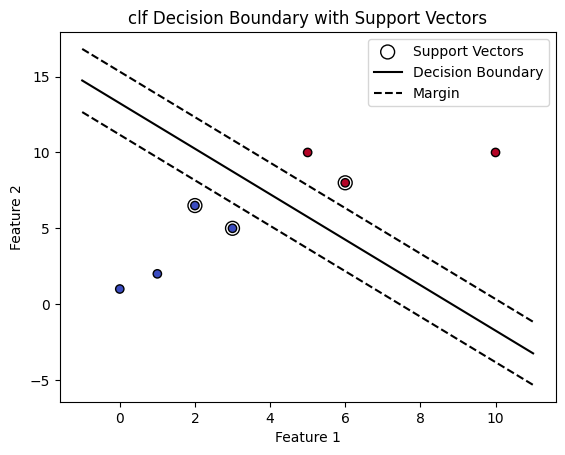

In [10]:
# Extract the weights (w) and intercept (b)
w = clf.coef_[0]
b = clf.intercept_[0]

# Compute x-values for decision boundary
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
x_vals = np.linspace(x_min, x_max, 100)

# Compute y-values for the decision boundary
y_vals = -(w[0] * x_vals + b) / w[1]

# Compute margin lines (support vectors)
margin = 1 / np.sqrt(np.sum(w**2))
y_vals_margin_up = y_vals + margin
y_vals_margin_down = y_vals - margin

# Plot dataset
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], 
            s=100, facecolors='none', edgecolors='k', label="Support Vectors")

# Plot decision boundary and margins
plt.plot(x_vals, y_vals, 'k-', label="Decision Boundary")
plt.plot(x_vals, y_vals_margin_up, 'k--', label="Margin")
plt.plot(x_vals, y_vals_margin_down, 'k--')

plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.legend()
plt.title("clf Decision Boundary with Support Vectors")
plt.show()

### Compare probabilities from predict_proba and probability function from John C. Platt

In [12]:
sv = clf.support_vectors_
coef_ = clf.coef_
dual_coef = clf.dual_coef_
print("-- Support vectors\n", sv)
print("-- Dual coefficients\n", dual_coef)
print("-- Decision fonction scores\n", decision_fct_scores)
prob_A = clf.probA_
prob_B = clf.probB_

predicted_proba_svm_function = clf.predict_proba(X)
decision_fct_scores = clf.decision_function(X)/coef_

def compute_prob_platt(probA, probB, decision_fct_scores):
    return 1/(1+np.exp(probA * decision_fct_scores + probB))

predicted_proba_platt_function = compute_prob_platt(prob_A, prob_B, decision_fct_scores)
print("-- Proba Platt function\n", predicted_proba_platt_function)
print("-- Proba predict_proba function\n", predicted_proba_svm_function)

-- Support vectors
 [[2.  6.5]
 [3.  5. ]
 [6.  8. ]]
-- Dual coefficients
 [[-0.05322742 -0.06231931  0.11554673]]
-- Decision fonction scores
 [-3.26690939 -2.60024272 -0.99977934 -1.00011033  1.13362018  0.99988967
  3.13295822]


ValueError: operands could not be broadcast together with shapes (7,) (1,2) 

### Learn RBF SVM

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.datasets import make_classification

# Train an SVM with an RBF kernel
svm_rbf = SVC(kernel="rbf", C=1.0, gamma='scale')
svm_rbf.fit(X, y)

# Create a grid to evaluate model
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100),
                     np.linspace(y_min, y_max, 100))

# Predict on grid points
Z = svm_rbf.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Plot decision boundary and support vectors
plt.contourf(xx, yy, Z, alpha=0.3, cmap=plt.cm.coolwarm)
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.coolwarm, edgecolors='k')
plt.scatter(svm_rbf.support_vectors_[:, 0], svm_rbf.support_vectors_[:, 1], 
            s=100, facecolors='none', edgecolors='k', label="Support Vectors")

plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.legend()
plt.title("SVM Decision Boundary with RBF Kernel")
plt.show()

In [ ]:
import numpy as np
import plotly.graph_objects as go
from sklearn.svm import SVC
from sklearn.datasets import make_classification

# Generate synthetic 3D dataset
X, y = make_classification(n_samples=100, n_features=3, n_classes=2, 
                           n_informative=3, n_redundant=0, random_state=42)

# Train an SVM with RBF kernel
svm_rbf = SVC(kernel="rbf", C=1.0, gamma='scale')
svm_rbf.fit(X, y)

# Define grid for decision boundary
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
z_min, z_max = X[:, 2].min() - 1, X[:, 2].max() + 1

xx, yy = np.meshgrid(np.linspace(x_min, x_max, 30), 
                     np.linspace(y_min, y_max, 30))

# Compute decision function for grid points
Z = np.array([svm_rbf.decision_function([[x, y, (z_min + z_max) / 2]])[0] 
              for x, y in zip(xx.ravel(), yy.ravel())])
Z = Z.reshape(xx.shape)

# Create 3D plot
fig = go.Figure()

# Add decision boundary surface
fig.add_trace(go.Surface(x=xx, y=yy, z=Z, colorscale="blues", opacity=0.5))

# Add scatter plot for data points
fig.add_trace(go.Scatter3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], 
                           mode='markers', marker=dict(color=y, size=6, colorscale="Portland"), name="Data Points"))

# Add support vectors
fig.add_trace(go.Scatter3d(x=svm_rbf.support_vectors_[:, 0], 
                           y=svm_rbf.support_vectors_[:, 1], 
                           z=svm_rbf.support_vectors_[:, 2], 
                           mode='markers', marker=dict(symbol="circle", size=8, color='black', opacity=0.7),
                           name="Support Vectors"))

# Labels & Title
fig.update_layout(scene=dict(xaxis_title="Feature 1", 
                             yaxis_title="Feature 2", 
                             zaxis_title="Feature 3"),
                  title="3D SVM Decision Boundary (RBF Kernel)")

# Show interactive plot
fig.show()


In [ ]:
predicted_proba_svm_function = clf.predict_proba(X)
decision_fct_scores = clf.decision_function(X)
prob_A = clf.probA_
prob_B = clf.probB_

def compute_prob_platt(probA, probB, decision_fct_scores):
    return 1/(1+np.exp(probA * decision_fct_scores + probB))

predicted_proba_platt_function = compute_prob_platt(prob_A, prob_B, decision_fct_scores)
print("-- Proba Platt function\n", predicted_proba_platt_function)
print("-- Proba predict_proba function\n", predicted_proba_svm_function)

# Learning Sigmoid

In [1]:
import numpy as np

# Patient 229
xdata229 = np.array([0,  112,  469,  665,  777,  945, 1120, 1225])
ydata229 = np.array([43, 42, 42, 41, 40, 39, 39, 41])

# Patient 811
xdata811 = np.array([ 0  , 5,  51, 167, 426])
ydata811 = np.array([40, 40 ,39 ,38, 36])

# Patient 124
xdata124 = np.array([0   ,96 , 180 , 285,  376 , 481 , 579 , 690 , 777,  866 , 964 ,1041, 1132, 1154])
ydata124 = np.array([45, 42, 43 ,31, 29, 27, 27, 29 ,26, 25, 26, 24 ,18 ,18])

# Patient 829
xdata829 = np.array([ 0,   35,   84 , 216 , 314,  376,  483,  517,  556 , 629,  734,  832,  902,  965
, 1049 ,1119, 1252])
ydata829 = np.array([44 ,46 ,44 ,45 ,45 ,44 ,40, 38, 35, 22, 21 ,17, 19, 16 ,13 ,14 ,10])

# Patient 835
xdata835 = np.array([0   ,82,  189 , 364,  539,  721,  896, 1085, 1239, 1421, 1519 ,1694, 1876, 1967,
 2024 ,2149, 2190, 2330, 2337, 2435, 2533, 2659, 2778])
ydata835 = np.array([45 ,46 ,46 ,38 ,38, 38, 36 ,35, 33 ,34 ,34 ,34 ,31, 28 ,27, 25 ,22, 16 ,16 ,15, 15 ,16 ,12])

# Patient 966
xdata966 = np.array( [0   ,83  ,188  ,265  ,349  ,461 , 566 , 664,  776,  882,  972, 1070, 1160, 1272,
 1331 ,1482, 1573, 1791, 2267])
ydata966 = np.array([38, 37, 32, 30 ,26 ,28 ,25 ,23 ,23 ,17, 19, 18, 18, 20, 18 ,19 ,19 ,19, 21])

# Patient 368
xdata368 = np.array([ 0  ,20 , 83, 161, 251, 260, 279, 310, 364, 462, 477, 490, 539])
ydata368 = np.array([41, 41, 31 ,27 ,26, 27 ,26 ,22 ,23 ,22 ,15 ,13, 12])

# Patient 805
xdata805 = np.array([0  ,56 ,222, 329 ,427 ,510, 650, 762 ,860])
ydata805 = np.array([34 ,33, 27 ,28 ,17 ,17 ,17 ,19 ,16])

# Patient 366
xdata366 = np.array([0, 378, 476, 608, 652, 818])
ydata366 = np.array([37, 39, 35, 34, 36, 33])

# Patient 1657
xdata1657 = np.array([0,  23,  56, 139 ,245, 258])
ydata1657 = np.array([43 ,43 ,43 ,43 ,39 ,37])

# Patient 1112
xdata1112 = np.array([0,   6,  77 ,154, 175, 190])
ydata1112 = np.array([21, 21, 19, 19, 17, 10])

# Patient 596
xdata596 = np.array([ 0,   91,  161,  202 , 300,  545,  664,  790,  909, 1014, 1112, 1182, 1245, 1322,
1413, 1553, 1658, 1749, 1868, 1959, 2092, 2224, 2336])
ydata596 = np.array([42, 37, 38, 39, 38 ,37, 35, 30, 28, 25, 23, 23, 24, 24 ,26, 24, 25, 25, 25, 25, 25, 23, 24])

In [2]:
def sigmoid(x,Z, L, x0, k, b):
    return L / (Z + np.exp(-k * (x - x0))) + b

def sigmoid_v2(x, k):
    return -1 / 1 + np.exp(-k * (x))

def sigmoid_v3(x, b, k, a):
    return (b) / (1 + np.exp((k * x) - a))

def sigmoid_v4(x, b, k, a, c):
    return (b) / (1 + np.exp((k * (x - a)))) + c

def sigmoid_v5(x, k, a, c):
    return (48 / (1 + np.exp((k * (x - a))))) + c

In [9]:
xdata = xdata829
ydata = ydata829

b = 50.57808140726644
k = 0.003606638571959266
a = 2.6646315243931067
error = 203.802221938424
Solution for x when y = 24: 767.1033589050896


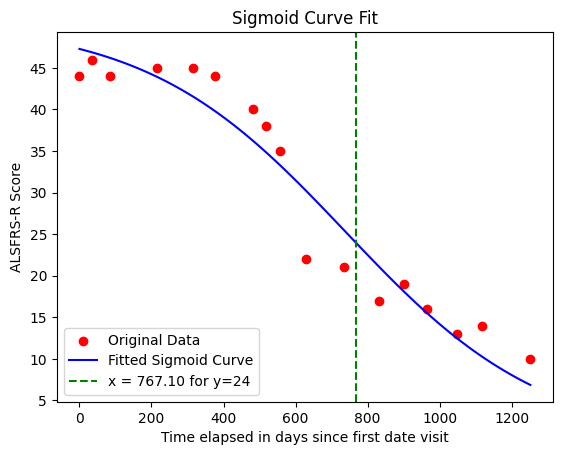

In [4]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

p0 = [48, 0, 0]

lowest_float_value = 2.22e-16
popt, pcov, infodict, i1, i2 = curve_fit(sigmoid_v3,
                       xdata, 
                       ydata,
                       p0=p0, 
                       full_output=True,
                       maxfev=100000)

b, k, a = popt[0], popt[1], popt[2]
print("b =", b)
print("k =", k)
print("a =", a)
print("error =", sum(np.power(infodict["fvec"],2)))

x_fit = np.linspace(min(xdata), max(xdata), 100)
y_fit = sigmoid_v3(x_fit, *popt)

def solve_for_x(b, k, a, y=24):
    x = (np.log((b - y) / y) + a) / k
    return x

x_solution = solve_for_x(*popt, y=24)

print(f"Solution for x when y = 24: {x_solution}")

plt.scatter(xdata, ydata, label="Original Data", color="red")
plt.plot(x_fit, y_fit, label="Fitted Sigmoid Curve", color="blue")

plt.axvline(x_solution, color="green", linestyle="--", label=f"x = {x_solution:.2f} for y=24")

plt.xlabel("Time elapsed in days since first date visit")
plt.ylabel("ALSFRS-R Score")
plt.title("Sigmoid Curve Fit")
plt.legend()
plt.show()

b = 30.441928044515592
k = 0.01417298872879977
a = 591.0267248626237
c = 14.687717363347025
error = 73.29304370508784
Solution for x when y = 24: 648.836889204661


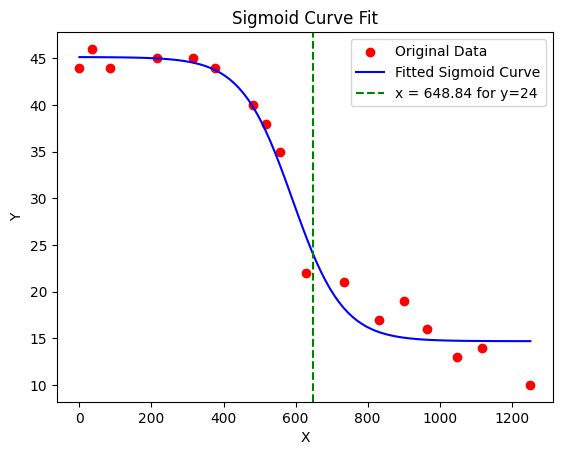

In [ ]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

p0 = [48, 0, 0, 0]

lowest_float_value = 2.22e-16
popt, pcov, infodict, i1, i2 = curve_fit(sigmoid_v4,
                       xdata, 
                       ydata,
                       p0=p0, 
                       full_output=True,
                       maxfev=100000)

b, k, a, c = popt[0], popt[1], popt[2], popt[3]
print("b =", b)
print("k =", k)
print("a =", a)
print("c =", c)
print("error =", sum(np.power(infodict["fvec"],2)))

x_fit = np.linspace(min(xdata), max(xdata), 100)
y_fit = sigmoid_v4(x_fit, *popt)

def solve_for_x(b, k, a, c, y=24):
    term = (b / (y - c)) - 1
    x = (np.log(term) / k) + a
    return x

x_solution = solve_for_x(*popt, y=24)

print(f"Solution for x when y = 24: {x_solution}")

plt.scatter(xdata, ydata, label="Original Data", color="red")
plt.plot(x_fit, y_fit, label="Fitted Sigmoid Curve", color="blue")

plt.axvline(x_solution, color="green", linestyle="--", label=f"x = {x_solution:.2f} for y=24")

plt.xlabel("X")
plt.ylabel("Y")
plt.title("Sigmoid Curve Fit")
plt.legend()
plt.show()

In [ ]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

p0 = [0, 0, 0]

popt, pcov, infodict, i1, i2 = curve_fit(sigmoid_v5,
                       xdata, 
                       ydata,
                       p0=p0, 
                       full_output=True,
                       maxfev=100000000)

k, a, c = popt[0], popt[1], popt[2]
print("k =", b)
print("a =", k)
print("c =", a)
print("error =", sum(np.power(infodict["fvec"],2)))

x_fit = np.linspace(min(xdata), max(xdata), 100)
y_fit = sigmoid_v5(x_fit, *popt)

def solve_for_x(k, a, c, y=24):
    term = (48 / (y - c)) - 1
    x = (np.log(term) / k) + a
    return x

x_solution = solve_for_x(*popt, y=24)

print(f"Solution for x when y = 24: {x_solution}")

plt.scatter(xdata, ydata, label="Original Data", color="red")
plt.plot(x_fit, y_fit, label="Fitted Sigmoid Curve", color="blue")

plt.axvline(x_solution, color="green", linestyle="--", label=f"x = {x_solution:.2f} for y=24")

plt.xlabel("X")
plt.ylabel("Y")
plt.title("Sigmoid Curve Fit")
plt.legend()
plt.show()

In [ ]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

p0 = [48, 0, 0, 0]

lowest_float_value = 2.22e-16
popt, pcov, infodict, i1, i2 = curve_fit(sigmoid_v4,
                       xdata, 
                       ydata,
                       p0=p0,
                       #bounds=((-np.inf, -np.inf, -np.inf, -np.inf),(np.inf, np.inf, np.inf, 23)),
                       bounds=[[0, 0, 0, -48],[48, 10, xdata[-1], 23]],
                       full_output=True,
                       maxfev=100000)

b, k, a, c = popt[0], popt[1], popt[2], popt[3]
print("b =", b)
print("k =", k)
print("a =", a)
print("c =", c)
print("error =", sum(np.power(infodict["fvec"],2)))

x_fit = np.linspace(min(xdata), max(xdata), 100)
y_fit = sigmoid_v4(x_fit, *popt)

def solve_for_x(b, k, a, c, y=24):
    term = (b / (y - c)) - 1
    x = (np.log(term) / k) + a
    return x

x_solution = solve_for_x(*popt, y=24)

print(f"Solution for x when y = 24: {x_solution}")

plt.scatter(xdata, ydata, label="Original Data", color="red")
plt.plot(x_fit, y_fit, label="Fitted Sigmoid Curve", color="blue")

plt.axvline(x_solution, color="green", linestyle="--", label=f"x = {x_solution:.2f} for y=24")

plt.xlabel("X")
plt.ylabel("Y")
plt.title("Sigmoid Curve Fit")
plt.legend()
plt.show()

In [17]:
np.power([1,2],2)

array([1, 4], dtype=int32)

b = 38.00000000000001
k = 0.006513310198980992
a = 630.6291300722745
c = 9.972393001343988
error = 120.10096289429987
42.25067214265767
Value of D50 when y = 24: 712.9030497661396


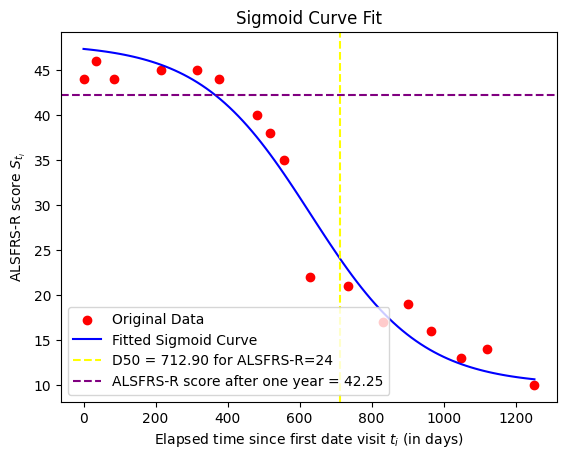

In [ ]:
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt

p0 = [48, 1.0E-5, 0, 0]

popt, pcov, infodict, i1, i2 = curve_fit(sigmoid_v4,
                       xdata, 
                       ydata,
                       p0=p0,
                       bounds=((38, 0, 0, -10),(48, 10, xdata[-1], 10)),
                       full_output=True,
                       maxfev=10000000)

b, k, a, c = popt[0], popt[1], popt[2], popt[3]
print("b =", b)
print("k =", k)
print("a =", a)
print("c =", c)
print("error =", sum(np.power(infodict["fvec"],2)))

x_fit = np.linspace(min(xdata), max(xdata), 100)
y_fit = sigmoid_v4(x_fit, *popt)

def solve_for_x(b, k, a, c, y=24):
    term = (b / (y - c)) - 1
    x = (np.log(term) / k) + a
    return x

x_solution = solve_for_x(*popt, y=24)
y_one_year = sigmoid_v4(365, *popt)
print(y_one_year)

print(f"Value of D50 when y = 24: {x_solution}")

plt.scatter(xdata, ydata, label="Original Data", color="red")
plt.plot(x_fit, y_fit, label="Fitted Sigmoid Curve", color="blue")

plt.axvline(x_solution, color="yellow", linestyle="--", label=f"D50 = {x_solution:.2f} for ALSFRS-R=24")
plt.axhline(y_one_year, color="purple", linestyle="--", label=f"ALSFRS-R score after one year = {y_one_year:.2f}")

plt.xlabel("Elapsed time since first date visit " + r"$t_i$" + " (in days)")
plt.ylabel("ALSFRS-R score " + r"$S_{t_i}$")
plt.title("Sigmoid Curve Fit")
plt.legend()
plt.show()

# SNORKEL: 2 Dimensions (DURATION_DIFF, SLOPE_DIFF)

In [4]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn import svm
import os

# Adapt path
path_csv = os.path.join(os.getcwd(), "..", "..", "IO Files", "Stratification", "Snorkel Labeled Pairs", "ft_labeled_pairs_sample_2D.csv")

df = pd.read_csv(path_csv)

print(df.head(5))

# Select only two features
columns = ["DURATION_DIFF", "SLOPE_DIFF"]
X = np.array(df[columns])
y = np.array(df.iloc[:, -1])

# Filter out class -1 for training
train_mask = y != -1
X_train = X[train_mask]
y_train = y[train_mask]

def linear_svm_2d(X, y, X_train, y_train):
    clf = svm.SVC(kernel='linear', C=0.03)
    clf.fit(X_train, y_train)  # Train only on classes 0 and 1
    w = clf.coef_[0]
    a, b = -w[0] / w[1], - (clf.intercept_[0]) / w[1]  # Equation of decision boundary

    # Create meshgrid for decision boundary
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    xx = np.linspace(x_min, x_max, 50)
    yy = a * xx + b  # Compute decision boundary

    # Create plotly figure
    fig = go.Figure()

    # Scatter plot for class 1
    fig.add_trace(go.Scatter(
        x=X[y == 1, 0], y=X[y == 1, 1],
        mode='markers', marker=dict(color='blue', size=5, symbol='circle'),
        name='Class 1'
    ))

    # Scatter plot for class 0
    fig.add_trace(go.Scatter(
        x=X[y == 0, 0], y=X[y == 0, 1],
        mode='markers', marker=dict(color='red', size=5, symbol='circle'),
        name='Class 0'
    ))

    # Scatter plot for class -1 (still shown but not trained on)
    fig.add_trace(go.Scatter(
        x=X[y == -1, 0], y=X[y == -1, 1],
        mode='markers', marker=dict(color='gray', size=5, symbol='x'),
        name='Class -1'
    ))

    # Decision boundary
    fig.add_trace(go.Scatter(
        x=xx, y=yy, mode='lines', line=dict(color='green', width=2),
        name='Decision Boundary'
    ))

    # Print details
    print("Weights =", clf.coef_)
    print("Intercept =", clf.intercept_)
    print("Equation: y =", a, "* x +", b)

    fig.update_layout(
        title='2D Linear SVM with Decision Boundary',
        xaxis_title=columns[0],
        yaxis_title=columns[1],
        showlegend=True
    )

    fig.show()

linear_svm_2d(X, y, X_train, y_train)

   ID1_PATIENT  ID2_PATIENT  DURATION_DIFF  SLOPE_DIFF  LABEL
0            5            7       0.065672    0.060809     -1
1            5           12       0.189925    0.457166      1
2            5           23       0.169403    0.382457      1
3            5           24       0.167910    0.092233     -1
4            5           30       0.143657    0.018603      0
Weights = [[8.87300373 9.35547463]]
Intercept = [-2.20448506]
Equation: y = -0.9484290300992503 * x + 0.23563583302896757


# SNORKEL: 3D

In [3]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn import svm
import os

# Adapt path
path_csv = os.path.join(os.getcwd(), "..", "..", "IO Files", "Stratification", "Snorkel Labeled Pairs", "ft_labeled_pairs_sample_3D.csv")

df = pd.read_csv(path_csv)

print(df.head(5))

# Select three features
X = np.array(df.iloc[:,2:-1])
y = np.array(df.iloc[:, -1])

columns = df.iloc[:,2:-1].columns.values
# Filter out class -1 for training
train_mask = y != -1
X_train = X[train_mask]
y_train = y[train_mask]

def linear_svm_3d(X, y, X_train, y_train):
    clf = svm.SVC(kernel='linear', C=0.8)
    clf.fit(X_train, y_train)  # Train only on classes 0 and 1
    w = clf.coef_[0]
    d = - (clf.intercept_[0]) / w[2]  # Solve for Z in decision boundary equation

    # Create meshgrid for decision boundary
    xx, yy = np.meshgrid(np.linspace(0, 1, 30), np.linspace(0, 1, 30))
    zz = (-w[0] * xx - w[1] * yy - clf.intercept_[0]) / w[2] # Compute Z values for decision plane

    # Create 3D plotly figure
    fig = go.Figure()

    # Scatter plot for class 1
    fig.add_trace(go.Scatter3d(
        x=X[y == 1, 0], y=X[y == 1, 1], z=X[y == 1, 2],
        mode='markers', marker=dict(color='blue', size=5, symbol='circle'),
        name='Class 1'
    ))

    # Scatter plot for class 0
    fig.add_trace(go.Scatter3d(
        x=X[y == 0, 0], y=X[y == 0, 1], z=X[y == 0, 2],
        mode='markers', marker=dict(color='red', size=5, symbol='circle'),
        name='Class 0'
    ))

    # Scatter plot for class -1 (still shown but not trained on)
    fig.add_trace(go.Scatter3d(
        x=X[y == -1, 0], y=X[y == -1, 1], z=X[y == -1, 2],
        mode='markers', marker=dict(color='gray', size=5, symbol='circle'),
        name='Class -1'
    ))

    # Decision boundary plane
    fig.add_trace(go.Surface(x=xx, y=yy, z=zz, colorscale='Viridis', opacity=0.5, name='Decision Boundary'))

    # Print details
    print("Weights =", clf.coef_)
    print("Intercept =", clf.intercept_)
    print(f"Equation: {w[0]} * x + {w[1]} * y + {w[2]} * z + {clf.intercept_[0]} = 0")

    fig.update_layout(
        title='3D Linear SVM with Decision Boundary',
        scene=dict(
            xaxis=dict(title=columns[0], range=[0, 1]),
            yaxis=dict(title=columns[1], range=[0, 1]),
            zaxis=dict(title=columns[2], range=[0, 1])
        ),
        showlegend=True
    )

    fig.show()

linear_svm_3d(X, y, X_train, y_train)

   ID1_PATIENT  ID2_PATIENT  SLOPE_DIFF  ALS_SCORE_M12_DIFF  D50_DIFF  LABEL
0            5            7    0.060701            0.319301  0.155396     -1
1            5           12    0.456353            0.338146  0.102376      1
2            5           23    0.381777            0.434998  0.080022      1
3            5           24    0.092069            0.228095  0.107057     -1
4            5           30    0.018570            0.234025  0.082530      0
Weights = [[ 7.89445369 11.90261885 12.11012922]]
Intercept = [-5.05028533]
Equation: 7.89445369492377 * x + 11.90261884635429 * y + 12.110129222628741 * z + -5.050285328959447 = 0


# Snorkel ALLFEAT

In [13]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn import svm
import os

# Adapt path
path_csv = os.path.join(os.getcwd(), "..", "..", "IO Files", "Stratification", "Snorkel Labeled Pairs", "labeled_pairs_snorkel_svm_allfeat.csv")

df = pd.read_csv(path_csv)

print(df.head(5))

# Select three features
X = np.array(df.iloc[:,4:-2])
y = np.array(df.iloc[:, -1])

columns = df.iloc[:,4:-2].columns.values
# Filter out class -1 for training
train_mask = y != -1
X_train = X[train_mask]
y_train = y[train_mask]

def linear_svm_3d(X, y, X_train, y_train):
    clf = svm.SVC(kernel='linear', C=1)
    clf.fit(X_train, y_train)  # Train only on classes 0 and 1
    w = clf.coef_[0]
    d = - (clf.intercept_[0]) / w[2]  # Solve for Z in decision boundary equation

    # Create meshgrid for decision boundary
    xx, yy = np.meshgrid(np.linspace(0, 1, 30), np.linspace(0, 1, 30))
    zz = (-w[0] * xx - w[1] * yy - clf.intercept_[0]) / w[2] # Compute Z values for decision plane

    # Create 3D plotly figure
    fig = go.Figure()

    # Scatter plot for class 1
    fig.add_trace(go.Scatter3d(
        x=X[y == 1, 0], y=X[y == 1, 1], z=X[y == 1, 2],
        mode='markers', marker=dict(color='blue', size=5, symbol='circle'),
        name='Class 1'
    ))

    # Scatter plot for class 0
    fig.add_trace(go.Scatter3d(
        x=X[y == 0, 0], y=X[y == 0, 1], z=X[y == 0, 2],
        mode='markers', marker=dict(color='red', size=5, symbol='circle'),
        name='Class 0'
    ))

    # Scatter plot for class -1 (still shown but not trained on)
    fig.add_trace(go.Scatter3d(
        x=X[y == -1, 0], y=X[y == -1, 1], z=X[y == -1, 2],
        mode='markers', marker=dict(color='gray', size=5, symbol='circle'),
        name='Class -1'
    ))

    # Decision boundary plane
    fig.add_trace(go.Surface(x=xx, y=yy, z=zz, colorscale='Viridis', opacity=0.5, name='Decision Boundary'))

    # Print details
    print("Weights =", clf.coef_)
    print("Intercept =", clf.intercept_)
    print(f"Equation: {w[0]} * x + {w[1]} * y + {w[2]} * z + {clf.intercept_[0]} = 0")

    fig.update_layout(
        title='3D Linear SVM with Decision Boundary',
        scene=dict(
            xaxis=dict(title=columns[0], range=[0, 1]),
            yaxis=dict(title=columns[1], range=[0, 1]),
            zaxis=dict(title=columns[2], range=[0, 1])
        ),
        showlegend=True
    )

    fig.show()

linear_svm_3d(X, y, X_train, y_train)

   DURATION_DIFF  SLOPE_DIFF   FV_DIFF  HCS_DIFF  PC_CHANGE_M6_DIFF  \
0       0.065672    0.060701  0.142857  0.037484           0.145262   
1       0.189925    0.456353  0.000000  0.204646           0.442702   
2       0.169403    0.381777  0.000000  0.537195           0.257011   
3       0.167910    0.092069  0.000000  0.019368           0.102669   
4       0.143657    0.018570  0.392857  0.007433           0.112072   

   PC_CHANGE_M12_DIFF  ALS_SCORE_M12_DIFF  ALS_SCORE_M6_DIFF  D50_DIFF  LABEL  
0            0.341953            0.319301           0.135735  0.155396      1  
1            0.365631            0.338146           0.394578  0.102376      1  
2            0.474508            0.434998           0.244430  0.080022      1  
3            0.245378            0.228095           0.095393  0.107057      0  
4            0.132408            0.234025           0.272058  0.082530      0  
Weights = [[5.24158105 8.28555391 2.74574958 3.35572722]]
Intercept = [-3.38151735]
Equation:

# SNORKEL: 3D UMAP Dimensions (DURATION_DIFF, SLOPE_DIFF, FV_DIFF, HCS_DIFF)

In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn import svm
import os
import umap

path_csv = os.path.join(os.getcwd(), "..", "..", "IO Files", "Stratification", "Snorkel Labeled Pairs", "ft_labeled_pairs_sample_DSFH.csv")

"""
Labels -----
TOGETHER = 0
SEPARATED = 1
------------ 
"""

columns = ["DURATION_DIFF", "SLOPE_DIFF", "FV_DIFF", "HCS_DIFF"]
df = pd.read_csv(path_csv)
X = np.array(df[columns])
y = np.array(df.iloc[:, -1])

reducer = umap.UMAP(n_components=3, random_state=42, n_jobs=1)

In [2]:
def linear_svm(X, y):
    clf = svm.SVC(kernel='linear')
    
    # Perform UMAP dimensionality reduction
    X_reduced = reducer.fit_transform(X)
    
    # Fit the SVM model
    clf.fit(X_reduced, y)
    
    # Extract the weights and intercept from the SVM model
    w = clf.coef_[0]
    a, b, c = -w[0] / w[2], -w[1] / w[2], - (clf.intercept_[0]) / w[2]
    
    # Create meshgrid for the decision boundary
    xx, yy = np.meshgrid(
        np.linspace(min(X_reduced[:, 0]), max(X_reduced[:, 0]), 50),
        np.linspace(min(X_reduced[:, 1]), max(X_reduced[:, 1]), 50)
    )
    
    # Calculate the z-values for the decision boundary (hyperplane)
    zz = a * xx + b * yy + c
    
    fig = go.Figure()
    
    # Add scatter plot for class 1
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 1, 0], y=X_reduced[y == 1, 1], z=X_reduced[y == 1, 2],
        mode='markers',
        marker=dict(color='blue', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 1'
    ))
    
    # Add scatter plot for class 0
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 0, 0], y=X_reduced[y == 0, 1], z=X_reduced[y == 0, 2],
        mode='markers',
        marker=dict(color='red', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 0'
    ))

    # Add scatter plot for class -1
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 0, 0], y=X_reduced[y == -1, 1], z=X_reduced[y == -1, 2],
        mode='markers',
        marker=dict(color='red', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 0'
    ))
    
    # Add support vectors
    fig.add_trace(go.Scatter3d(
        x=clf.support_vectors_[:, 0], y=clf.support_vectors_[:, 1], z=clf.support_vectors_[:, 2],
        mode='markers',
        marker=dict(size=8, color='black', symbol='x', opacity=0.5),
        name='Support Vectors'
    ))
    
    # Add the hyperplane (decision boundary) as a surface
    fig.add_trace(go.Surface(
        x=xx, y=yy, z=zz,
        opacity=0.5, colorscale='Viridis', showscale=False, name="Hyperplane"
    ))
    
    # Print details
    print("Weights =", clf.coef_)
    print("Intercept =", clf.intercept_)
    print("a =", a)
    print("b =", b)
    print("c =", c)
    print("Measure =",(X_reduced[:, 0] * w[0] + X_reduced[:, 1] * w[1] + X_reduced[:, 2] * w[2]) + a + b + c)
    
    # Update the layout for 3D plot
    fig.update_layout(
        title='3D Linear SVM with Decision Boundary',
        scene=dict(
            xaxis=dict(title="Component 1"),
            yaxis=dict(title="Component 2"),
            zaxis=dict(title="Component 3")
        ),
        showlegend=True
    )
    
    # Display the plot
    fig.show()

linear_svm(X, y)

Weights = [[0.13199036 0.27760864 0.13306808]]
Intercept = [-2.1402007]
a = -0.9919010107175571
b = -2.0862151425404716
c = 16.083501822020413
Measure = [15.622493 16.667763 14.509739 ... 15.855066 14.619969 15.203128]


In [ ]:
def rbf_svm(X, y):
    clf = svm.SVC(kernel='rbf', C=100000, gamma='scale')
    
    # Perform UMAP dimensionality reduction
    X_reduced = reducer.fit_transform(X)
    
    # Fit the SVM model
    clf.fit(X_reduced, y)
    
    # Create grid for decision function
    x_min, x_max = X_reduced[:, 0].min() - 1, X_reduced[:, 0].max() + 1
    y_min, y_max = X_reduced[:, 1].min() - 1, X_reduced[:, 1].max() + 1
    z_min, z_max = X_reduced[:, 2].min() - 1, X_reduced[:, 2].max() + 1

    xx, yy, zz = np.meshgrid(
        np.linspace(x_min, x_max, 30),
        np.linspace(y_min, y_max, 30),
        np.linspace(z_min, z_max, 30)
    )
    
    # Compute decision function values
    grid = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    decision_values = clf.decision_function(grid)
    decision_values = decision_values.reshape(xx.shape)

    fig = go.Figure()

    # Add scatter plot for Class 1
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 1, 0], y=X_reduced[y == 1, 1], z=X_reduced[y == 1, 2],
        mode='markers',
        marker=dict(color='blue', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 1'
    ))

    # Add scatter plot for Class 0
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 0, 0], y=X_reduced[y == 0, 1], z=X_reduced[y == 0, 2],
        mode='markers',
        marker=dict(color='red', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 0'
    ))

    # Add support vectors
    fig.add_trace(go.Scatter3d(
        x=clf.support_vectors_[:, 0], y=clf.support_vectors_[:, 1], z=clf.support_vectors_[:, 2],
        mode='markers',
        marker=dict(size=8, color='black', symbol='x', opacity=0.5),
        name='Support Vectors'
    ))

    # Add decision region as a semi-transparent volume
    fig.add_trace(go.Volume(
        x=xx.ravel(), y=yy.ravel(), z=zz.ravel(),
        value=decision_values.ravel(),
        opacity=0.2,  # Transparency for better visibility
        isomin=-0.1, isomax=0.1,  # Define range for decision boundary
        surface_count=15,  # More surfaces = more refined visualization
        colorscale='Viridis',
        name="Decision Boundary"
    ))

    # Update the layout for the 3D plot
    fig.update_layout(
        title='3D SVM (RBF Kernel) Decision Boundary',
        scene=dict(
            xaxis=dict(title="Component 1"),
            yaxis=dict(title="Component 2"),
            zaxis=dict(title="Component 3")
        ),
        showlegend=True
    )

    # Display the plot
    fig.show()

rbf_svm(X, y)

# SNORKEL: 3D UMAP Dimensions ALLFEAT

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from sklearn import svm
import os
import umap

# Load dataset
path_csv = os.path.join(os.getcwd(), "..", "..", "IO Files", "Stratification", "Snorkel Labeled Pairs", "ft_labeled_pairs_sample_ALLFEAT.csv")

"""
Labels -----
TOGETHER = 0
SEPARATED = 1
------------
"""

df = pd.read_csv(path_csv)
X = np.array(df.iloc[:, :-1])  # All features except the label
y = np.array(df.iloc[:, -1])   # Label column

# UMAP for dimensionality reduction
reducer = umap.UMAP(n_neighbors=5, n_components=3, min_dist=0.01, random_state=42, n_jobs=1)

In [2]:
def linear_svm(X, y):
    X_reduced = reducer.fit_transform(X)
    clf = svm.SVC(kernel='linear')
    clf.fit(X_reduced, y)

    w = clf.coef_[0]
    a, b, c = -w[0] / w[2], -w[1] / w[2], - (clf.intercept_[0]) / w[2]
    
    # Create meshgrid for the decision boundary plane
    xx, yy = np.meshgrid(
        np.linspace(min(X_reduced[:, 0]), max(X_reduced[:, 0]), 50),
        np.linspace(min(X_reduced[:, 1]), max(X_reduced[:, 1]), 50)
    )
    
    # Calculate the z-values of the hyperplane
    zz = a * xx + b * yy + c
    
    fig = go.Figure()
    
    # Add scatter plot for class 1
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 1, 0], y=X_reduced[y == 1, 1], z=X_reduced[y == 1, 2],
        mode='markers',
        marker=dict(color='blue', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 1'
    ))
    
    # Add scatter plot for class 0
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 0, 0], y=X_reduced[y == 0, 1], z=X_reduced[y == 0, 2],
        mode='markers',
        marker=dict(color='red', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 0'
    ))
    
    # Add support vectors
    fig.add_trace(go.Scatter3d(
        x=clf.support_vectors_[:, 0], y=clf.support_vectors_[:, 1], z=clf.support_vectors_[:, 2],
        mode='markers',
        marker=dict(size=8, color='black', symbol='x', opacity=0.5),
        name='Support Vectors'
    ))
    
    # Add the hyperplane (decision boundary) as a surface
    fig.add_trace(go.Surface(
        x=xx, y=yy, z=zz,
        opacity=0.5, colorscale='Viridis', showscale=False, name="Hyperplane"
    ))
    
    # Print details
    print("Weights =", clf.coef_)
    print("Intercept =", clf.intercept_)
    print("a =", a)
    print("b =", b)
    print("c =", c)
    print("Measure =",(X_reduced[:, 0] * w[0] + X_reduced[:, 1] * w[1] + X_reduced[:, 2] * w[2]) + a + b + c)
    
    fig.update_layout(
        title='3D Linear SVM with Decision Boundary',
        scene=dict(
            xaxis=dict(title="Component 1"),
            yaxis=dict(title="Component 2"),
            zaxis=dict(title="Component 3")
        ),
        showlegend=True
    )
    
    fig.show()

linear_svm(X, y)

Weights = [[-0.10317299  0.64327544  0.39803598]]
Intercept = [-2.43845729]
a = 0.25920519216533067
b = -1.616123867444108
c = 6.1262233404318245
Measure = [12.7273     9.717349   7.089704  ... 10.503077   8.419614   5.8195376]


In [3]:
def rbf_svm(X, y):
    # Reduce to 3D using UMAP
    X_reduced = reducer.fit_transform(X)

    # Train an SVM with an RBF kernel
    clf = svm.SVC(kernel='rbf', C=1.0, gamma='scale')
    clf.fit(X_reduced, y)

    # Create a 3D grid for decision function visualization
    x_min, x_max = X_reduced[:, 0].min() - 1, X_reduced[:, 0].max() + 1
    y_min, y_max = X_reduced[:, 1].min() - 1, X_reduced[:, 1].max() + 1
    z_min, z_max = X_reduced[:, 2].min() - 1, X_reduced[:, 2].max() + 1

    xx, yy, zz = np.meshgrid(
        np.linspace(x_min, x_max, 30),
        np.linspace(y_min, y_max, 30),
        np.linspace(z_min, z_max, 30)
    )

    # Compute decision function values
    grid = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
    decision_values = clf.decision_function(grid)
    decision_values = decision_values.reshape(xx.shape)

    fig = go.Figure()

    # Add scatter plot for Class 1
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 1, 0], y=X_reduced[y == 1, 1], z=X_reduced[y == 1, 2],
        mode='markers',
        marker=dict(color='blue', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 1'
    ))

    # Add scatter plot for Class 0
    fig.add_trace(go.Scatter3d(
        x=X_reduced[y == 0, 0], y=X_reduced[y == 0, 1], z=X_reduced[y == 0, 2],
        mode='markers',
        marker=dict(color='red', size=5, symbol='circle', line=dict(color='black', width=1)),
        name='Class 0'
    ))

    # Add support vectors
    fig.add_trace(go.Scatter3d(
        x=clf.support_vectors_[:, 0], y=clf.support_vectors_[:, 1], z=clf.support_vectors_[:, 2],
        mode='markers',
        marker=dict(size=8, color='black', symbol='x', opacity=0.5),
        name='Support Vectors'
    ))

    # Add decision boundary as a volume
    fig.add_trace(go.Volume(
        x=xx.ravel(), y=yy.ravel(), z=zz.ravel(),
        value=decision_values.ravel(),
        opacity=0.2,  # Make it semi-transparent
        isomin=-0.1, isomax=0.1,  # Define the boundary range
        surface_count=15,  # More surfaces = finer detail
        colorscale='Viridis',
        name="Decision Boundary"
    ))

    # Update layout
    fig.update_layout(
        title='3D SVM (RBF Kernel) Decision Boundary',
        scene=dict(
            xaxis=dict(title="Component 1"),
            yaxis=dict(title="Component 2"),
            zaxis=dict(title="Component 3")
        ),
        showlegend=True
    )

    # Show the plot
    fig.show()

rbf_svm(X, y)